In [1]:
%cd /data/gunsbrother/repos/vq2d-lightning
%load_ext autoreload
%autoreload 2

/data/gunsbrother/repos/vq2d-lightning


/home/gunsbrother/.local/lib/python3.12/site-packages/IPython/core/magics/osm.py:417: UserWarning: This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [2]:
from IPython.display import Image as IPImage

from ltvu.lit.model import LitModule
from ltvu.lit.data import LitVQ2DDataModule
from ltvu.dataset.vq2d import VQ2DFitDataset

import decord
import hydra
from hydra.core.global_hydra import GlobalHydra
from omegaconf import OmegaConf
from diffusers.utils import make_image_grid

from scipy.signal import find_peaks, medfilt

import torch
import torchvision.transforms.functional as TF
from einops import rearrange, repeat
from PIL import Image, ImageDraw
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from io import BytesIO
from pathlib import Path

GlobalHydra.instance().clear()
OmegaConf.clear_resolvers()
OmegaConf.register_new_resolver("job_type", lambda : 'debug')
OmegaConf.register_new_resolver('runtime_outdir', lambda : 'outputs/tmp')
OmegaConf.register_new_resolver("eval", eval)
OmegaConf.register_new_resolver("tuple", lambda *args: tuple(args))
hydra.initialize(config_path='config', job_name='asdasdasdasdasd')

/tmp/ipykernel_1540965/2582894577.py:31: UserWarning: 
The version_base parameter is not specified.
Please specify a compatability version level, or None.
Will assume defaults for version 1.1
  hydra.initialize(config_path='config', job_name='asdasdasdasdasd')


hydra.initialize()

In [3]:
path_ckpt = 'outputs/batch/2024-09-15/123741/epoch=61-prob_acc=0.7739.ckpt'
plm_base = LitModule.load_from_checkpoint(path_ckpt).cuda()
plm_base.eval()
plm_base.freeze()

path_ckpt = 'outputs/ckpts/34597/epoch=47-prob_acc=0.7977.ckpt'
plm = LitModule.load_from_checkpoint(path_ckpt).cuda()
plm.eval()
plm.freeze()

eval_config = hydra.compose(config_name='eval', overrides=[
    f'ckpt={path_ckpt.replace('=', '\\=')}',
    f'batch_size=1',
    f'num_workers=4',
    f'prefetch_factor=1'
])
pdm = LitVQ2DDataModule(eval_config)  # won't use trainer here nor batched forward pass so no need to load the eval config and plm.config is enough
pdm.batch_size = 1

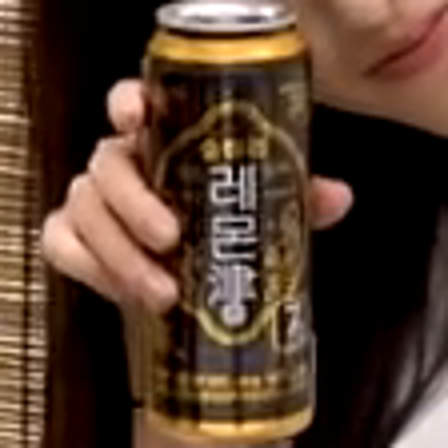

In [4]:
query = Image.open('/data/gunsbrother/prjs/ltvu2/VQLoC/samples/i3jpejz-PPc/query_crop.png')
display(query)
query = TF.to_tensor(query).unsqueeze(0).cuda()

In [ ]:
vr = decord.VideoReader('/data/gunsbrother/prjs/ltvu2/VQLoC/samples/i3jpejz-PPc/[i3jpejz-PPc]-796x448-00:23:27-29.97.mp4')
target_frame = int(837.8*29.97)
ds = VQ2DFitDataset(eval_config)

In [ ]:
segments = vr[target_frame:target_frame+6*32:6]
segments = rearrange(segments, 'b h w c -> b c h w') / 255.
segments_padded, _ = ds.pad_and_resize(segments, np.array([[0., 0., 0., 0.]]))
segments_padded = segments_padded.cuda()

In [7]:
with torch.inference_mode():
    input_segments, input_query = pdm.normalize(segments_padded[None], query)
    out = plm.model.forward(
        segment=input_segments,
        query=input_query,
        before_query_mask=torch.randn(1, 32).cuda(),
        gt_probs=torch.randn(1, 32).cuda(),
        gt_bboxes=torch.randn(1, 32, 4).cuda(),
        compute_loss=True, get_intermediate_features=False, training=False)

W1122 16:30:17.997000 140323883030336 torch/_dynamo/variables/tensor.py:715] [1/0] Graph break from `Tensor.item()`, consider setting:
W1122 16:30:17.997000 140323883030336 torch/_dynamo/variables/tensor.py:715] [1/0]     torch._dynamo.config.capture_scalar_outputs = True
W1122 16:30:17.997000 140323883030336 torch/_dynamo/variables/tensor.py:715] [1/0] or:
W1122 16:30:17.997000 140323883030336 torch/_dynamo/variables/tensor.py:715] [1/0]     env TORCHDYNAMO_CAPTURE_SCALAR_OUTPUTS=1
W1122 16:30:17.997000 140323883030336 torch/_dynamo/variables/tensor.py:715] [1/0] to include these operations in the captured graph.
W1122 16:30:17.997000 140323883030336 torch/_dynamo/variables/tensor.py:715] [1/0] 
/data/gunsbrother/anaconda3/envs/vq2d/lib/python3.12/site-packages/torch/_inductor/compile_fx.py:150: UserWarning: TensorFloat32 tensor cores for float32 matrix multiplication available but not enabled. Consider setting `torch.set_float32_matmul_precision('high')` for better performance.
  war

In [8]:
out['info_dict']['preds_top']['prob'].sigmoid()

tensor([[0.4125, 0.6919, 0.7481, 0.7271, 0.6872, 0.4944, 0.4763, 0.3924, 0.4267,
         0.4427, 0.4516, 0.1061, 0.1601, 0.1034, 0.0789, 0.0932, 0.1006, 0.0709,
         0.1023, 0.0673, 0.0816, 0.0593, 0.0748, 0.1659, 0.2331, 0.2238, 0.3324,
         0.3320, 0.3892, 0.3226, 0.2856, 0.1594]], device='cuda:0')

Text(0, 0.5, 'Prob')

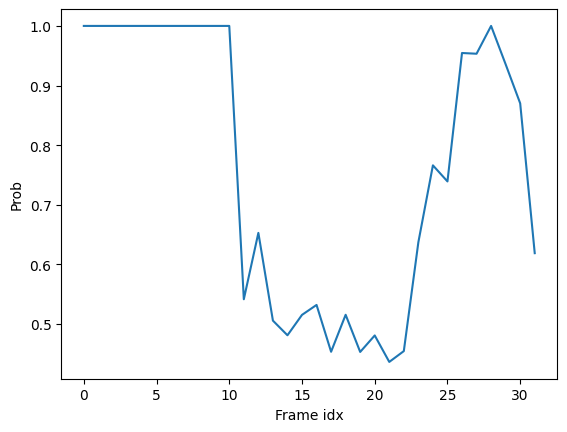

In [ ]:
probs = pred_probs[0].cpu().numpy()
probs -= .1
probs *= 2
probs = (probs + .5).clip(0, 1)
plt.plot(probs)
plt.xlabel('Frame idx')
plt.ylabel('Prob')

In [10]:
from tqdm.auto import tqdm

In [11]:
probs = []
bboxes = []

pbar = tqdm(total=target_frame + 1200)
start_frame = 0
while start_frame < target_frame + 1200:
    segments = vr[start_frame:start_frame+6*32:6]
    segments = rearrange(segments, 'b h w c -> b c h w') / 255.
    segments, _ = ds.pad_and_resize(segments, np.array([[0., 0., 0., 0.]]))
    segments = segments.cuda()

    with torch.inference_mode():
        segments, input_query = pdm.normalize(segments[None], query)
        out = plm_base.model.forward(
            segment=segments,
            query=input_query,
            before_query_mask=torch.randn(1, 32).cuda(),
            gt_probs=torch.randn(1, 32).cuda(),
            gt_bboxes=torch.randn(1, 32, 4).cuda(),
            compute_loss=True, get_intermediate_features=False, training=False)
        pred_probs = out['info_dict']['preds_top']['prob'].sigmoid().squeeze(0)
        probs.append(pred_probs.cpu().numpy())
        bboxes.append(out['info_dict']['preds_top']['bbox'].cpu().numpy().squeeze(0))

    start_frame += 6*32
    pbar.update(6*32)

probs = np.concatenate(probs, axis=0)
bboxes = np.concatenate(bboxes, axis=0)
np.save('outputs/tmp/probs_base.npy', probs)
np.save('outputs/tmp/bboxes_base.npy', bboxes)

  0%|          | 0/26308 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [12]:
probs = []
bboxes = []

pbar = tqdm(total=target_frame + 1200)
start_frame = 0
while start_frame < target_frame + 1200:
    segments = vr[start_frame:start_frame+6*32:6]
    segments = rearrange(segments, 'b h w c -> b c h w') / 255.
    segments, _ = ds.pad_and_resize(segments, np.array([[0., 0., 0., 0.]]))
    segments = segments.cuda()

    with torch.inference_mode():
        segments, input_query = pdm.normalize(segments[None], query)
        out = plm.model.forward(
            segment=segments,
            query=input_query,
            before_query_mask=torch.randn(1, 32).cuda(),
            gt_probs=torch.randn(1, 32).cuda(),
            gt_bboxes=torch.randn(1, 32, 4).cuda(),
            compute_loss=True, get_intermediate_features=False, training=False)
        pred_probs = out['info_dict']['preds_top']['prob'].sigmoid().squeeze(0)
        probs.append(pred_probs.cpu().numpy())
        bboxes.append(out['info_dict']['preds_top']['bbox'].cpu().numpy().squeeze(0))

    start_frame += 6*32
    pbar.update(6*32)

probs = np.concatenate(probs, axis=0)
bboxes = np.concatenate(bboxes, axis=0)
np.save('outputs/tmp/probs.npy', probs)
np.save('outputs/tmp/bboxes.npy', bboxes)

  0%|          | 0/26308 [00:00<?, ?it/s]

W1122 16:30:45.973000 140323883030336 torch/_dynamo/convert_frame.py:762] [2/8] torch._dynamo hit config.cache_size_limit (8)
W1122 16:30:45.973000 140323883030336 torch/_dynamo/convert_frame.py:762] [2/8]    function: 'torch_dynamo_resume_in_get_cross_cls_attn_score_at_585' (/data/gunsbrother/repos/vq2d-lightning/ltvu/models/vqloc.py:585)
W1122 16:30:45.973000 140323883030336 torch/_dynamo/convert_frame.py:762] [2/8]    last reason: L['___stack0'] == 10.06566333770752                         
W1122 16:30:45.973000 140323883030336 torch/_dynamo/convert_frame.py:762] [2/8] To log all recompilation reasons, use TORCH_LOGS="recompiles".
W1122 16:30:45.973000 140323883030336 torch/_dynamo/convert_frame.py:762] [2/8] To diagnose recompilation issues, see https://pytorch.org/docs/main/torch.compiler_troubleshooting.html.


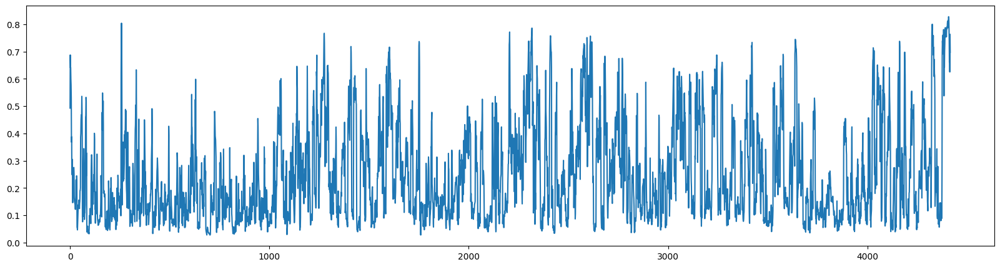

In [13]:
plt.figure(figsize=(20, 5))
plt.plot(probs)
plt.show()

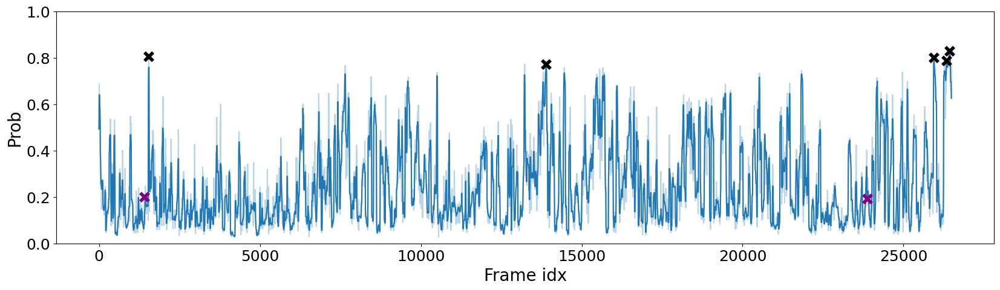

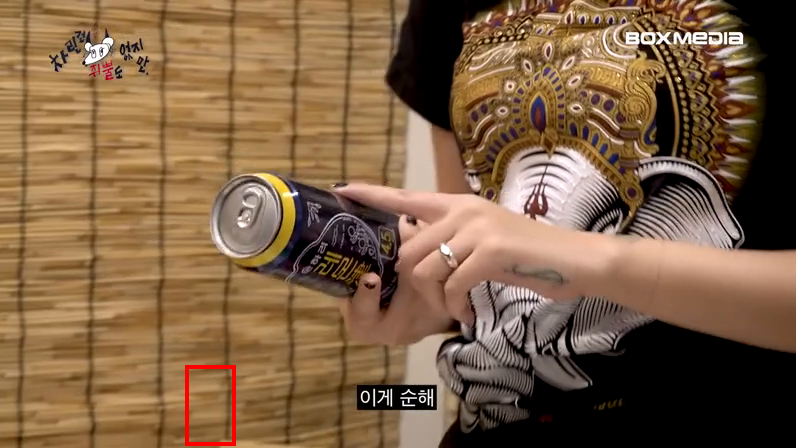

IndexError: index 13896 is out of bounds for axis 0 with size 4416

In [14]:
np.random.seed(1)
probs_sm = medfilt(probs, 5)
peaks, _ = find_peaks(probs_sm)
peaks = peaks[probs_sm[peaks] > .75]

random_points = np.random.randint(0, len(probs), 2)

plt.figure(figsize=(20, 5))
x = np.arange(0, 6*len(probs), 6)
pp = plt.plot(x, probs, alpha=.3)
color = pp[0].get_color()
plt.plot(x, probs_sm, color=color)
plt.plot(6*peaks, probs[peaks], 'x', c='k', ms=10, mew=4)
plt.plot(6*random_points, probs[random_points], 'x', c='purple', ms=10, mew=4)

plt.setp(plt.gca().get_xticklabels(), fontsize=18)
plt.setp(plt.gca().get_yticklabels(), fontsize=18)
plt.xlabel('Frame idx', fontsize=20)
plt.ylabel('Prob', fontsize=20)
plt.ylim(0, 1)
plt.show()

for fidx in peaks:
    fidx = 6 * fidx
    frame = Image.fromarray(vr[fidx].numpy())
    ow, oh = frame.size
    draw = ImageDraw.Draw(frame)
    py1, px1, py2, px2 = bboxes[fidx]
    py1 -= (1 - oh/ow) / 2
    py2 -= (1 - oh/ow) / 2
    px1, py1, px2, py2 = map(int, [px1*ow, py1*ow, px2*ow, py2*ow])

    draw.rectangle([(px1, py1), (px2, py2)], outline='red', width=4)

    display(frame)

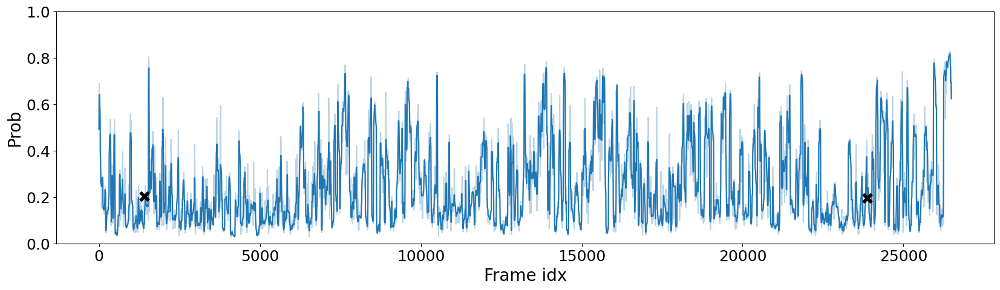

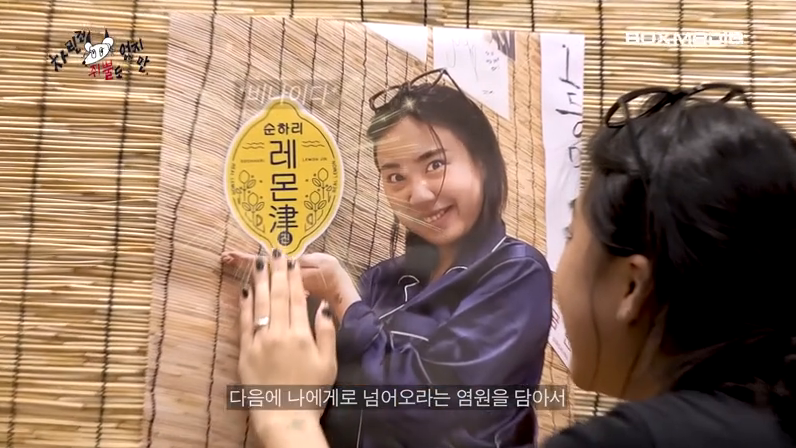

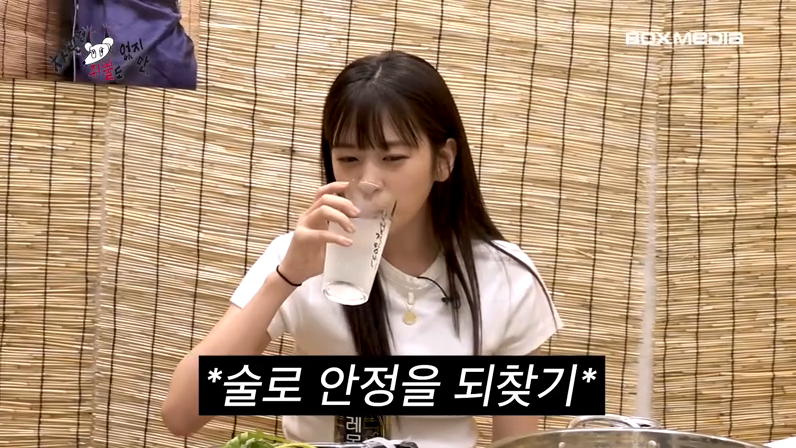

In [119]:
np.random.seed(1)
plt.figure(figsize=(20, 5))
x = np.arange(0, 6*len(probs), 6)
random_points = np.random.randint(0, len(probs), 2)
pp = plt.plot(x, probs, alpha=.3)
color = pp[0].get_color()
plt.plot(x, probs_sm, color=color)
plt.plot(6*random_points, probs[random_points], 'x', c='k', ms=10, mew=4)
plt.ylim(0, 1)

plt.setp(plt.gca().get_xticklabels(), fontsize=18)
plt.setp(plt.gca().get_yticklabels(), fontsize=18)
plt.xlabel('Frame idx', fontsize=20)
plt.ylabel('Prob', fontsize=20)
plt.show()

for point in random_points:
    fidx = 6 * point
    frame = Image.fromarray(vr[fidx].numpy())

    # ow, oh = frame.size
    # draw = ImageDraw.Draw(frame)
    # py1, px1, py2, px2 = bboxes[point]
    # py1 -= (1 - oh/ow) / 2
    # py2 -= (1 - oh/ow) / 2
    # px1, py1, px2, py2 = map(int, [px1*ow, py1*ow, px2*ow, py2*ow])
    # draw.rectangle([(px1, py1), (px2, py2)], outline='red', width=4)

    display(frame)

In [19]:
from tqdm.auto import tqdm

  0%|          | 0/4416 [00:00<?, ?it/s]

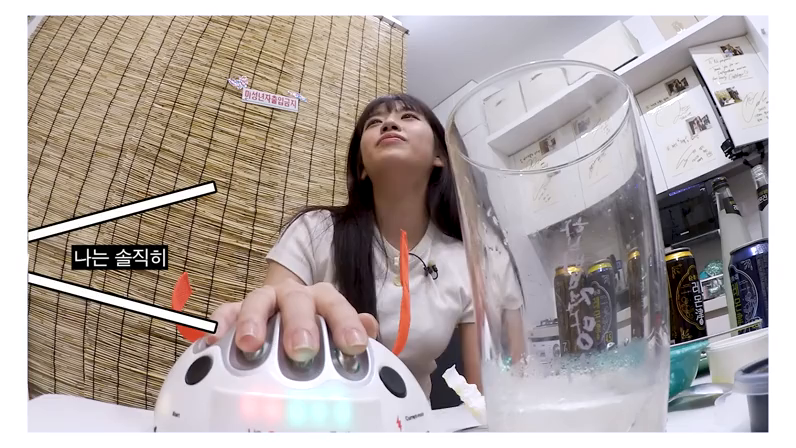

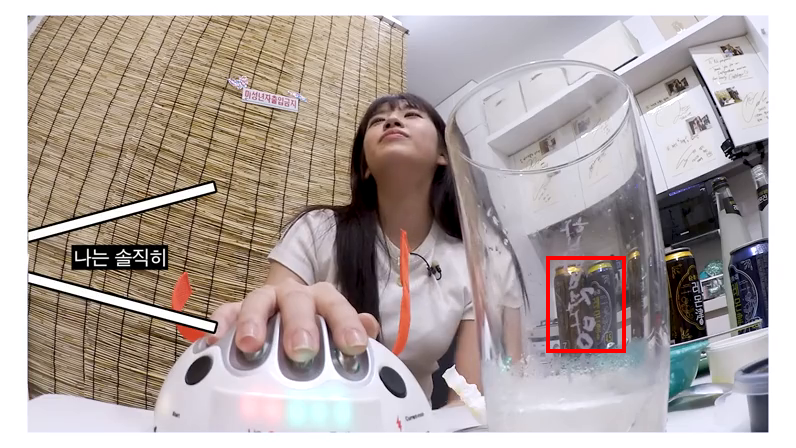

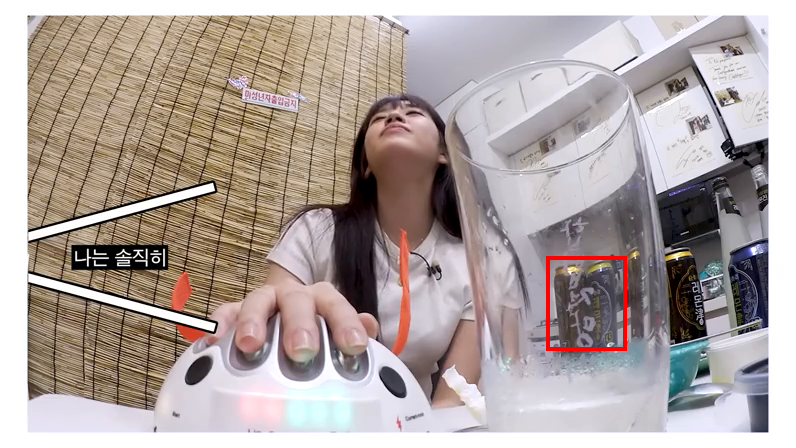

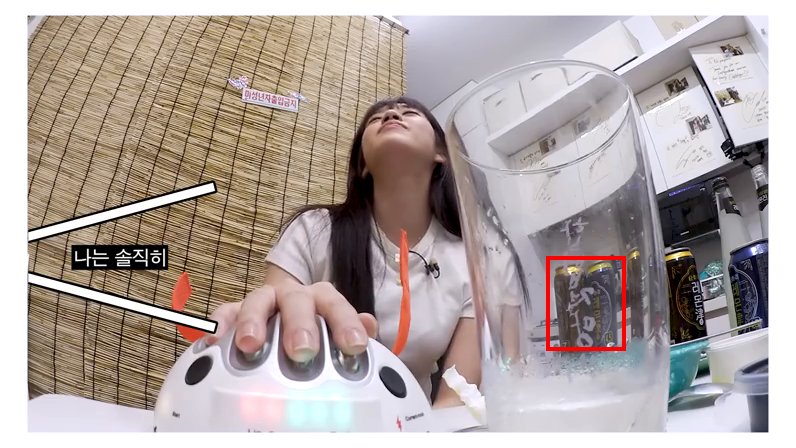

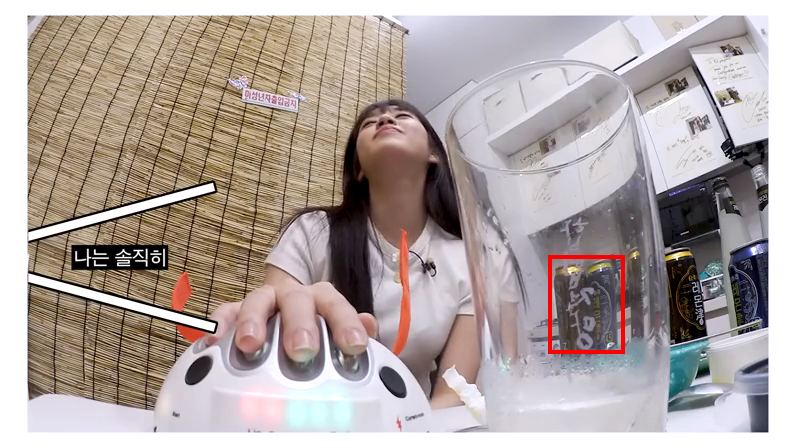

...

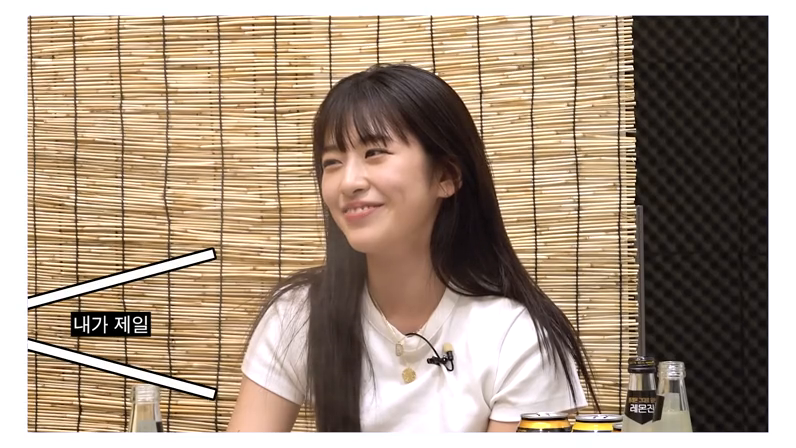

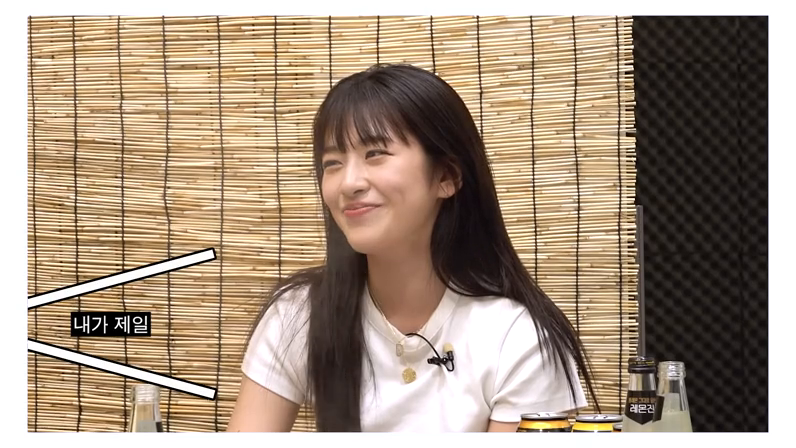

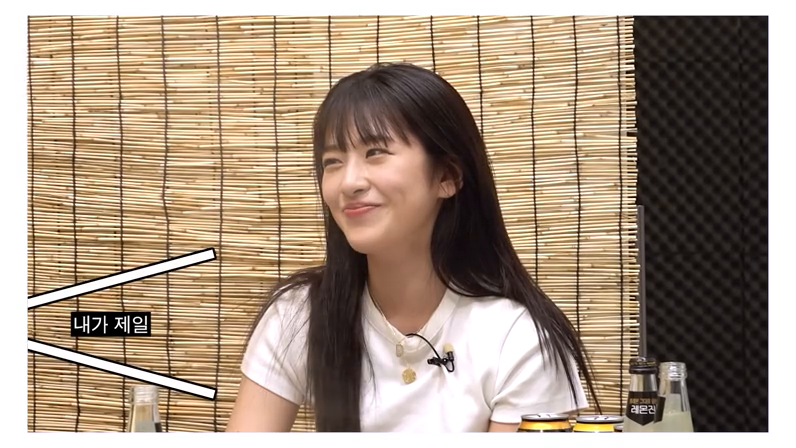

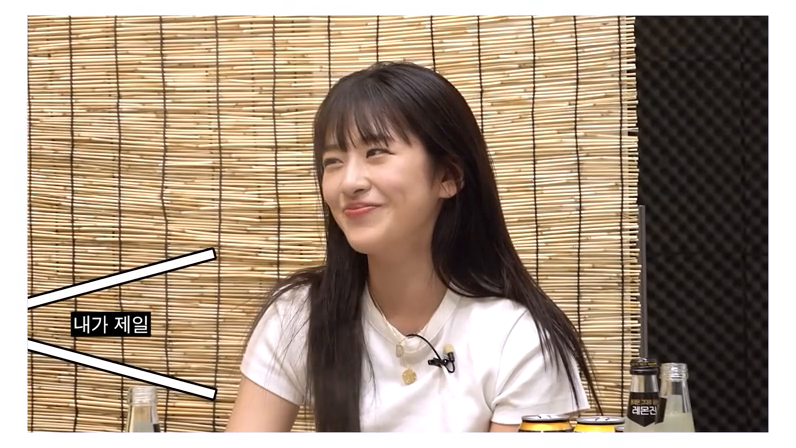

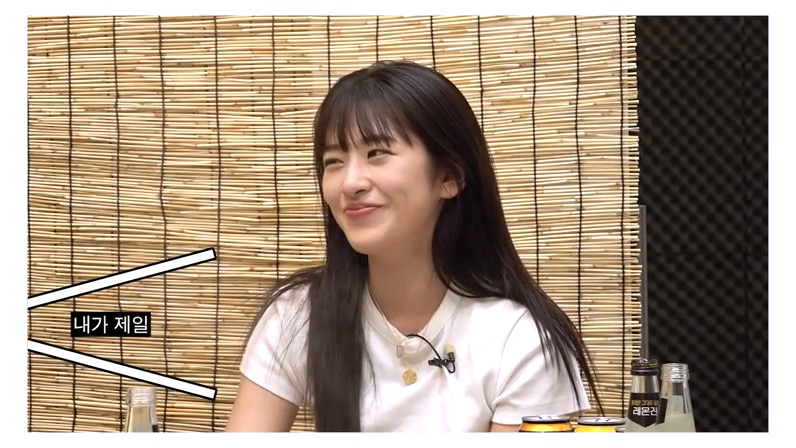

Video saved to outputs/viz/lemon_jin.mp4


In [22]:
import cv2
import numpy as np


# Parameters for the video
frame_rate = 5  # frames per second
output_path = f'outputs/viz/lemon_jin.mp4'
frame_size = Image.fromarray(vr[0].numpy()).size  # (width, height)


# OpenCV uses BGR color format, so PIL images need to be converted
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec for MP4
video_writer = cv2.VideoWriter(output_path, fourcc, frame_rate, frame_size)


fidxs = list(range(len(probs)))

for iii, fidx in enumerate(tqdm(fidxs)):
    py1, px1, py2, px2 = bboxes[fidx]
    score = probs[fidx]

    fidx = 6 * fidx
    frame = Image.fromarray(vr[fidx].numpy())

    if score > .5:
        ow, oh = frame.size
        draw = ImageDraw.Draw(frame)
        py1 -= (1 - oh/ow) / 2
        py2 -= (1 - oh/ow) / 2
        px1, py1, px2, py2 = map(int, [px1*ow, py1*ow, px2*ow, py2*ow])

        draw.rectangle([(px1, py1), (px2, py2)], outline='red', width=4)

    # frames.append(frame)
    if iii < 20:
        display(frame)

    frame = np.array(frame)
    frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
    video_writer.write(frame)

# for pil_img in frames:
#     frame = np.array(pil_img)
#     frame = cv2.cvtColor(frame, cv2.COLOR_RGB2BGR)
#     video_writer.write(frame)

# Release the video writer
video_writer.release()

print(f"Video saved to {output_path}")


In [ ]:
def compute_final_preds(preds, qset_uuid):
    ret_scores = preds[qset_uuid]['ret_scores']
    probs = ret_scores.sigmoid().cpu().numpy()
    probs_sm = medfilt(probs, kernel_size=5)
    peaks, _ = find_peaks(probs_sm)
    max_peak_prob = probs_sm[peaks].max()
    valid_peak_thres = max_peak_prob * 0.8
    peaks = peaks[probs_sm[peaks] > valid_peak_thres]
    last_valid_peak = peaks[-1]
    plat_thres = 0.7 * probs_sm[last_valid_peak]
    plat_idxs = np.where(probs_sm > plat_thres)[0]
    disc_idxs = np.where(np.diff(plat_idxs) > 1)[0]
    for i_from, i_to in zip(disc_idxs[:-1], disc_idxs[1:]):
        plat_idxs_tmp = plat_idxs[i_from+1:i_to]
        if last_valid_peak in plat_idxs_tmp:
            plat_idxs = plat_idxs_tmp
            break
    else:
        plat_idxs = plat_idxs[disc_idxs[-1]+1:]
    assert last_valid_peak in plat_idxs
    return probs, probs_sm, peaks, plat_idxs, plat_thres

# plot
probs, probs_sm, peaks, plat_idxs, plat_thres = compute_final_preds(inter_preds2, qset_uuid)
probs1, probs_sm1, peaks1, plat_idxs1, plat_thres1 = compute_final_preds(inter_preds1, qset_uuid)

fig, ax = plt.subplots(figsize=(10, 5))
plt.axvspan(gt_range[0], gt_range[1], color='g', alpha=0.2, label='GT interval')
plt.plot(peaks, probs[peaks], "x", color='k', markersize=8, markeredgewidth=4, zorder=10)
plt.plot(peaks1, probs1[peaks1], "x", color='k', label='peaks', markersize=8, markeredgewidth=4, zorder=10)

pp = plt.plot(probs1, label='VQLoC score')
color = pp[0].get_color()
plt.plot(plat_idxs1, probs1[plat_idxs1], color=color, lw=6, label='VQLoC final pred')

pp = plt.plot(probs, c=plt.get_cmap('tab20')(6), label='MATCH score')
color = pp[0].get_color()
plt.plot(plat_idxs, probs[plat_idxs], color=color, lw=6, label='MATCH final pred')

plt.setp(plt.gca().get_xticklabels(), fontsize=18)
plt.setp(plt.gca().get_yticklabels(), fontsize=18)
plt.gca().legend(
    loc='upper center', bbox_to_anchor=(0.5, 1.2),
    ncol=3, fancybox=True, shadow=True, fontsize=14)
plt.ylim(0, 1)
plt.show()

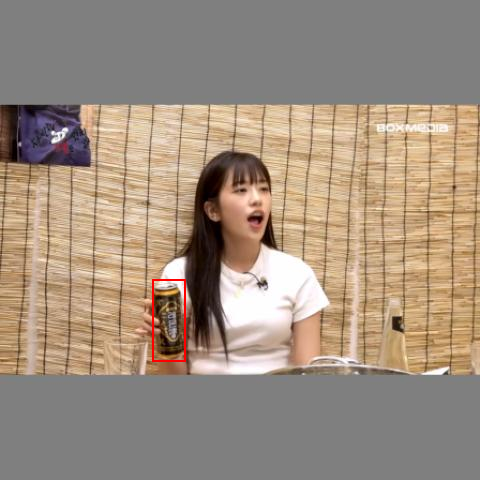

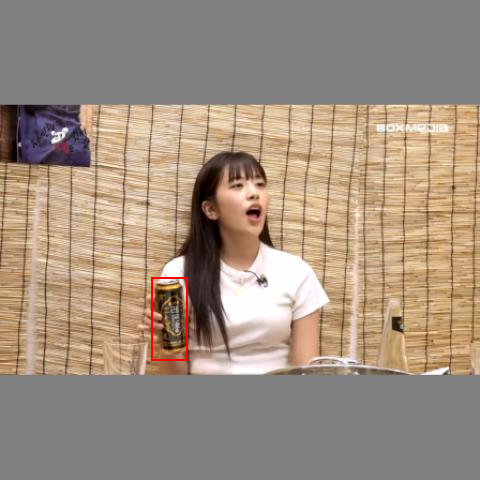

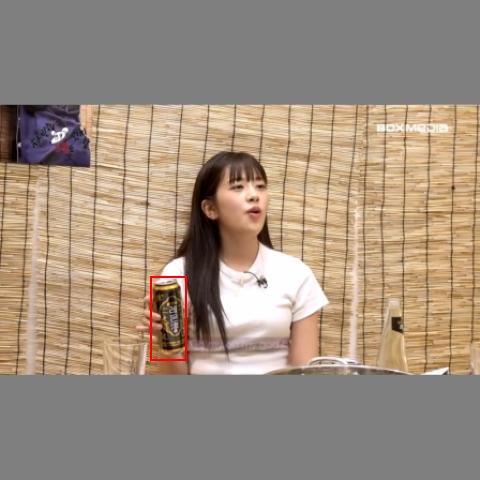

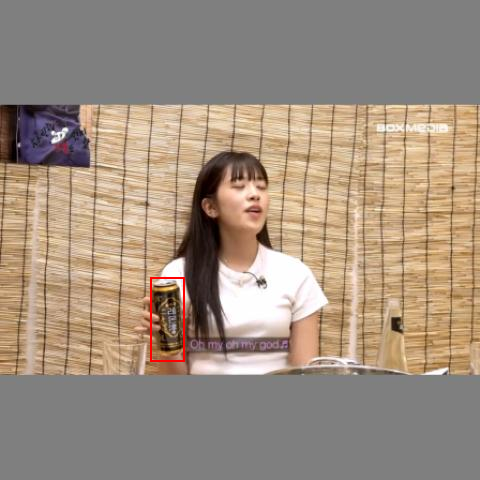

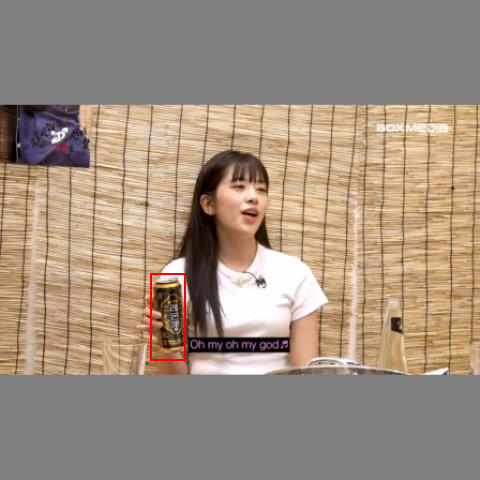

...

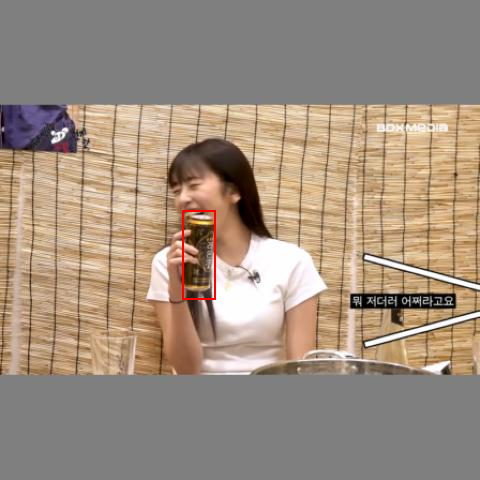

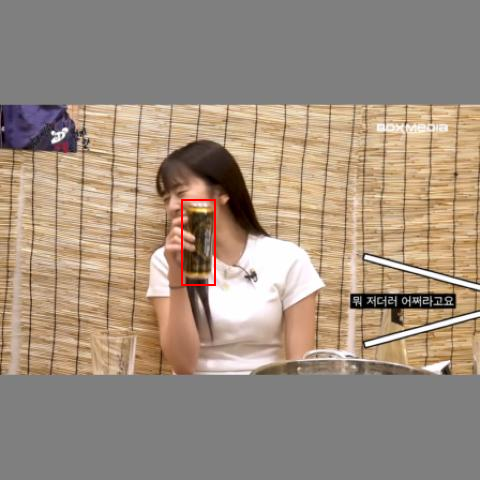

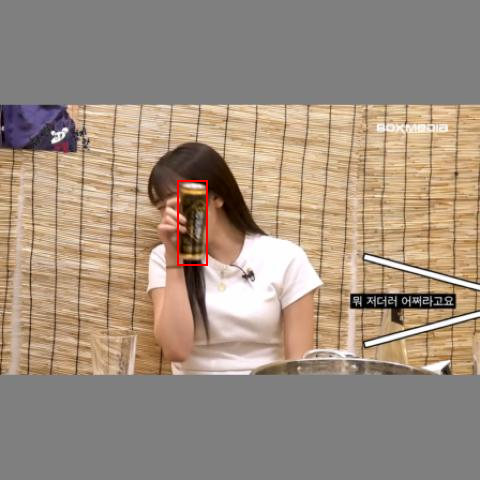

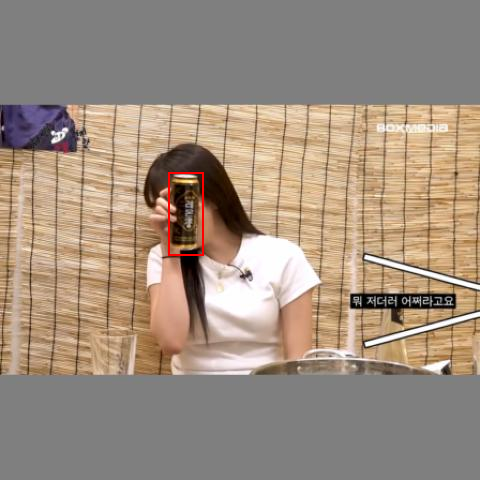

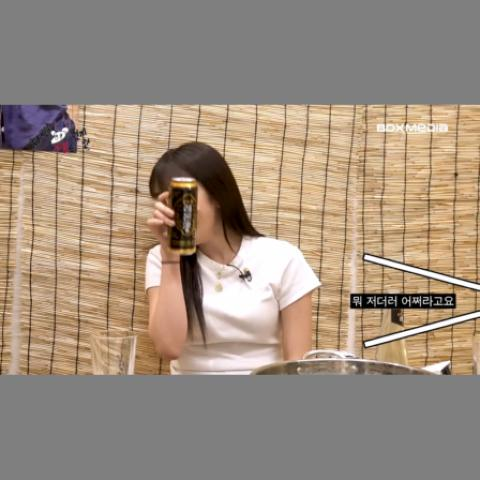

In [ ]:
from PIL import ImageDraw


pred_bboxes = out['info_dict']['preds_top']['bbox']
pred_probs = out['info_dict']['preds_top']['prob'].sigmoid()
for fidx in range(32):
    image = ten2pil(segments_padded[fidx]).convert('RGBA')

    py1, px1, py2, px2 = (image.size[0] * pred_bboxes[0, fidx]).cpu().numpy().astype(int)
    if pred_probs[0, fidx] > 0.2:
        draw = ImageDraw.Draw(image)
        draw.rectangle([(px1, py1), (px2, py2)], outline=(255, 0, 0), width=2)
    display(image)